#You will be able to create such distorted guitar or drum kit tracks through physical modeling synthesis instead of instrument sound samples.


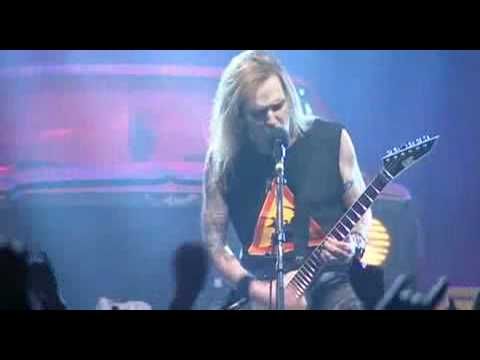

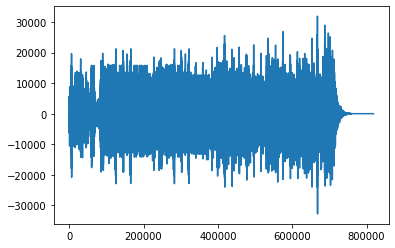

In [ ]:
#@title Unfortunately, Alexi Laiho passed away while I was coding his song... RIP our guitar hero, This is so sad...let me treat this song "cover" as a tribute to Alexi.
IPython.display.display(IPython.display.YouTubeVideo('jAh1RtQMj-s'))

def ks_drum(f, sr=44100, T=0.5,speed_of_release=1.999,tom=False):
    period = sr // f
    y = electric_wah_tone(period)
    y = y - mean(y)
    y_total = y.tolist()
    length = int(f * T)
    for i in range(length - 1):
        y = [((rand()-1) if tom else (randint(0,2)*2-1))* (y[i - 1] + y[i]) / speed_of_release for i in range(period)]
        y_total += y
    y_total = zeros(int(sr * T))[:len(y_total)] + y_total[:int(sr * T)]  # Zeros padding to normalize the signal size
    y_total = y_total / np.max(abs(y_total)) * (2 ** 15 - 1)
    return y_total
    
temple=135
speed = temple/240  # temple
keys_8 ={k:eq(v,1,1,0)*1.5 for k,v in keys_generator(1.3/16,1.999,electric_wah_tone,True).items()}
keys_8_low={k:eq(v,3,0,-0.8) for k,v in keys_8.items()}
keys_8_solo={k:eq(v,1,1,2) for k,v in keys_8.items()}
keys_4 =  {k:v.astype(int32)*1.7 for k,v in keys_generator(1.3/4,1.999,electric_wah_tone,True).items()}
cymbal1=eq(convolve(convolve(convolve(eq(ks_drum(50, sr, 2,1.55), -0.90, 0, 0.5),ones(500)/500),reverb_filter)[:40000],reverb_filter),-0.5,1,3) *2500
cymbal2=convolve(convolve(convolve(eq(ks_drum(1000, sr, 2,1.55), -0.90, 0.5, 1),ones(500)/500),reverb_filter)[:40000],reverb_filter) *3000
hihat_opened=eq(convolve(convolve(eq(ks_drum(5000, sr, 2,1.45), -1, 0.3, 3),reverb_filter)[:40000],reverb_filter), -1, 0.3, 3) *48
hihat_closed=convolve(convolve(eq(ks_drum(20, sr, 0.5,1.3), -1, 0, 10)[100:-2000],ones(500)/500)[:3000],reverb_filter)*6000
snare = convolve(eq(ks_drum(100, sr, 0.2), -0.5, 5, 3),ones(300)/300) *400
drum = eq(convolve(eq(ks_drum(250, sr, 0.2), 100, 5, -1),ones(300)/300),100,0,0) *0.00005
tom = convolve(eq(ks_drum(150, sr, 1), 30, -1, -1),ones(300)/300)
toms =[hamming(20000)*(30*tom[:20000]+append(zeros(2000),eq(convolve(eq(ks_drum(i, sr, 1,20,tom=True), 100, 5, -1),ones(400)/400)[:20000],-0.3,10,10))[:20000])/4  for i in arange(9,19,2)]

song = {"length": 0, "notes": []}
def intro_drum(song):
  song_add(song,drum*11,1/16)
  song_add_chord(song,[hihat_opened,snare*7],1/16,False,0.5)
  song_add(song,drum*11,1/16)
  song_add_chord(song,[toms[4]],1/16,False)
  song_add_chord(song,[cymbal2,drum*6],1/16,False)
  song_add_chord(song,[toms[4]],1/16,False)
  song_add(song,drum*10,1/16)
  song_add_chord(song,[hihat_opened*3,toms[2]],1/16,False)
  song_add(song,drum*9,1/16)
  song_add_chord(song,[toms[2]],1/16,False)
  song_add(song,drum*8,1/16)
  song_add_chord(song,[toms[0]*0.5],1/16,False)
  song_add_chord(song,[toms[0]*0.5],1/16,False)
  song_add(song,cymbal1*5,1/8)
  song_add(song,cymbal1*5,1/8)
intro_drum(song)
song["notes"]/=10
def riff1(song,type=None):
    hihat = hihat_closed if type==1 else hihat_opened/4
    song_add_chord(song, [cymbal1*3,cymbal2*3, drum*3,  keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False,0.9)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3,hihat_closed*6, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*1.5,  hihat_closed*4, keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*1.5, hihat_closed*4, keys_8['E3']*1.5, keys_8['B4']*1.5], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['G3'], keys_8['D4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [drum*1.5, hihat_closed*4, keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3, hihat*4, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3, hihat*4, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)

def riff2(song,type=None):
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal1*10, keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*9, snare*3.5, cymbal2*5,keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal2*3, keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal2*3, keys_8['G#2']*2, keys_8['Eb3']*2], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*2, keys_8['G#2']*1.25, keys_8['Eb3']*1.25], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, snare*1.5, cymbal2*3if type == 1 else cymbal1*10,keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*6, snare*3.5,cymbal2*5if type == 1 else zeros(1000), keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, zeros(1000) if type == 1 else cymbal1*10,keys_8_low['Bb3']*2.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, zeros(1000) if type == 1 else snare*3.5 , keys_8_low['Bb3']*2.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*3, cymbal2*4 if type == 1 else zeros(1000),snare*3.5 if type == 1 else zeros(1000),keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.8, keys_4['F#2'], keys_4['C#3']], 1 / 16, False, 0.8)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.3], 1 / 16, False)
    song_add_chord(song, [drum*2, cymbal2*0.8 if type == 1 else zeros(1000) ,snare*0.8], 1 / 16, False)
    song_add_chord(song, [drum*4, zeros(1000) if type == 1 else snare, keys_4['G#2'], keys_4['Eb3']], 1 / 16, False, 0.8)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.4], 1 / 16, False)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else hihat_opened*0.65], 1 / 16, False)


riff1(song,1)
song_add_chord(song, [cymbal1*1.5,drum*4,  keys_4['D3'], keys_4['A4'], keys_4['F3']], 3 / 16, False)
song_add_chord(song, [cymbal2,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
riff1(song)
song_add_chord(song, [cymbal1*1.5,drum*4,  keys_4['Bb3'], keys_4['F3'], keys_4['D3']], 3 / 16, False)
song_add_chord(song, [cymbal2,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
song['notes']*=1.5
solo_1 = {"length": 0, "notes": []}
riff_2 = {"length": 0, "notes": []}
riff2(riff_2,1)
song_add(solo_1, keys_8_solo['C#5'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['C#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb3'], 1 / 16)
solo_1['notes']=convolve(solo_1['notes'],reverb_filter)/2.5
song_add_chord(song, [solo_1["notes"], riff_2["notes"]*1.2], 2, False)
riff_2 = {"length": 0, "notes": []}
riff2(riff_2)
solo_2 = {"length": 0, "notes": []}
song_add(solo_2, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_2, keys_8_solo['E3'], 1 / 16)
song_add(solo_2, keys_8_solo['F3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 2 / 16)
song_add(solo_2, keys_8_solo['F#3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 1 / 16)
song_add(solo_2, keys_8_solo['A4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['C#5'], 1 / 16)
solo_2['notes']=convolve(solo_2['notes'],reverb_filter)/2.5
song_add_chord(song, [solo_2["notes"], riff_2["notes"]*1.2], 2, False)
song_add_chord(song, [drum*1.75,snare,cymbal1*3.5,cymbal2*3.5,keys_8_solo['D5'] ], 1 / 16, False)

song=convolve(song['notes'],reverb_filter[:sr//16])
song = eq(song, 0.5, 0.5, 0)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
plot(song)
show()
IPython.display.display(IPython.display.Audio(song, rate=sr))

    
temple=135
speed = temple/240  # temple
keys_8 ={k:eq(v,1,1,0)*1.5*0 for k,v in keys_generator(1.3/16,1.999,electric_wah_tone,True).items()}
keys_8_low={k:eq(v,3,0,-0.8)*0 for k,v in keys_8.items()}
keys_8_solo={k:eq(v,1,1,2) for k,v in keys_8.items()}
keys_4 = {k:zeros(sr) for k,v in keys_generator(1.3/4,1.999,electric_wah_tone,True).items()}
cymbal1=eq(convolve(convolve(convolve(eq(ks_drum(50, sr, 2,1.55), -0.90, 0, 0.5),ones(500)/500),reverb_filter)[:40000],reverb_filter),-0.5,1,3) *2500
cymbal2=convolve(convolve(convolve(eq(ks_drum(1000, sr, 2,1.55), -0.90, 0.5, 1),ones(500)/500),reverb_filter)[:40000],reverb_filter) *3000
hihat_opened=eq(convolve(convolve(eq(ks_drum(5000, sr, 2,1.45), -1, 0.3, 3),reverb_filter)[:40000],reverb_filter), -1, 0.3, 3) *48
hihat_closed=convolve(convolve(eq(ks_drum(20, sr, 0.5,1.3), -1, 0, 10)[100:-2000],ones(500)/500)[:3000],reverb_filter)*6000
snare = convolve(eq(ks_drum(100, sr, 0.2), -0.5, 5, 3),ones(300)/300) *400
drum = eq(convolve(eq(ks_drum(250, sr, 0.2), 100, 5, -1),ones(300)/300),100,0,0) *0.00006
tom = convolve(eq(ks_drum(150, sr, 1), 30, -1, -1),ones(300)/300)
toms =[hamming(20000)*(30*tom[:20000]+append(zeros(2000),eq(convolve(eq(ks_drum(i, sr, 1,20,tom=True), 100, 5, -1),ones(400)/400)[:20000],-0.3,10,10))[:20000])/4  for i in arange(9,19,2)]

song = {"length": 0, "notes": []}
intro_drum(song)
song["notes"]/=10
riff1(song,1)
song_add_chord(song, [cymbal1*3,drum*4,  keys_4['D3'], keys_4['A4'], keys_4['F3']], 3 / 16, False)
song_add_chord(song, [cymbal2*1.5,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
riff1(song)
song_add_chord(song, [cymbal1*3,drum*4,  keys_4['Bb3'], keys_4['F3'], keys_4['D3']], 3 / 16, False)
song_add_chord(song, [cymbal2*1.5,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
song['notes']*=1.5
solo_1 = {"length": 0, "notes": []}
riff_2 = {"length": 0, "notes": []}
riff2(riff_2,1)
song_add(solo_1, keys_8_solo['C#5'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['C#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb3'], 1 / 16)
solo_1['notes']=convolve(solo_1['notes'],reverb_filter)/3
song_add_chord(song, [solo_1["notes"], riff_2["notes"]*1.2], 2, False)
riff_2 = {"length": 0, "notes": []}
riff2(riff_2)
solo_2 = {"length": 0, "notes": []}
song_add(solo_2, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_2, keys_8_solo['E3'], 1 / 16)
song_add(solo_2, keys_8_solo['F3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 2 / 16)
song_add(solo_2, keys_8_solo['F#3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 1 / 16)
song_add(solo_2, keys_8_solo['A4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['C#5'], 1 / 16)
solo_2['notes']=convolve(solo_2['notes'],reverb_filter)/3
song_add_chord(song, [solo_2["notes"], riff_2["notes"]*1.2], 2, False)
song_add_chord(song, [drum*1.75,snare,cymbal1*3.5,cymbal2*3.5,keys_8_solo['D5'] ], 1 / 16, False)

song=convolve(song['notes'],reverb_filter[:sr//16])
song = eq(song, 0.5, 0.5, 0)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
IPython.display.display(IPython.display.Audio(song, rate=sr))




   
temple=135
speed = temple/240  # temple
keys_8 ={k:eq(v,1,1,0)*1.5 for k,v in keys_generator(1.3/16,1.999,electric_wah_tone,True).items()}
keys_8_low={k:eq(v,3,0,-0.8) for k,v in keys_8.items()}
keys_8_solo={k:eq(v,1,1,2) for k,v in keys_8.items()}
keys_4 =  {k:v.astype(int32)*1.7 for k,v in keys_generator(1.3/4,1.999,electric_wah_tone,True).items()}
cymbal1=0*eq(convolve(convolve(convolve(eq(ks_drum(50, sr, 2,1.55), -0.90, 0, 0.5),ones(500)/500),reverb_filter)[:40000],reverb_filter),-0.5,1,3) *2500
cymbal2=0*convolve(convolve(convolve(eq(ks_drum(1000, sr, 2,1.55), -0.90, 0.5, 1),ones(500)/500),reverb_filter)[:40000],reverb_filter) *3000
hihat_opened=0*eq(convolve(convolve(eq(ks_drum(5000, sr, 2,1.45), -1, 0.3, 3),reverb_filter)[:40000],reverb_filter), -1, 0.3, 3) *48
hihat_closed=0*convolve(convolve(eq(ks_drum(20, sr, 0.5,1.3), -1, 0, 10)[100:-2000],ones(500)/500)[:3000],reverb_filter)*6000
snare = 0*convolve(eq(ks_drum(100, sr, 0.2), -0.5, 5, 3),ones(300)/300) *400
drum = 0*eq(convolve(eq(ks_drum(250, sr, 0.2), 100, 5, -1),ones(300)/300),100,0,0) *0.00006
tom = 0*convolve(eq(ks_drum(150, sr, 1), 30, -1, -1),ones(300)/300)
toms =[0*hamming(20000)*(30*tom[:20000]+append(zeros(2000),eq(convolve(eq(ks_drum(i, sr, 1,20,tom=True), 100, 5, -1),ones(400)/400)[:20000],-0.3,10,10))[:20000])/4  for i in arange(9,19,2)]

song = {"length": 0, "notes": []}
intro_drum(song)
song["notes"]/=10

riff1(song,1)
song_add_chord(song, [cymbal1*3,drum*4,  keys_4['D3'], keys_4['A4'], keys_4['F3']], 3 / 16, False)
song_add_chord(song, [cymbal2*1.5,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
riff1(song)
song_add_chord(song, [cymbal1*3,drum*4,  keys_4['Bb3'], keys_4['F3'], keys_4['D3']], 3 / 16, False)
song_add_chord(song, [cymbal2*1.5,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
song['notes']*=1.5
solo_1 = {"length": 0, "notes": []}
riff_2 = {"length": 0, "notes": []}
riff2(riff_2,1)
song_add(solo_1, keys_8_solo['C#5'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['C#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb3'], 1 / 16)
solo_1['notes']=convolve(solo_1['notes'],reverb_filter)/3
song_add_chord(song, [solo_1["notes"], riff_2["notes"]*1.2], 2, False)
riff_2 = {"length": 0, "notes": []}
riff2(riff_2)
solo_2 = {"length": 0, "notes": []}
song_add(solo_2, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_2, keys_8_solo['E3'], 1 / 16)
song_add(solo_2, keys_8_solo['F3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 2 / 16)
song_add(solo_2, keys_8_solo['F#3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 1 / 16)
song_add(solo_2, keys_8_solo['A4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['C#5'], 1 / 16)
solo_2['notes']=convolve(solo_2['notes'],reverb_filter)/3
song_add_chord(song, [solo_2["notes"], riff_2["notes"]*1.2], 2, False)
song_add_chord(song, [drum*1.75,snare,cymbal1*3.5,cymbal2*3.5,keys_8_solo['D5'] ], 1 / 16, False)

song=convolve(song['notes'],reverb_filter[:sr//16])
song = eq(song, 0.5, 0.5, 0)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
IPython.display.display(IPython.display.Audio(song, rate=sr))


#String
Instruments like piano, guitar, bass, etc. all produce sound by the simple harmonic motion of strings when you pick the strings in their middle position (If you see some videos showing that the movement of the string is wavy, it is because these videos were taken by cameras with Rolling Shutter, which is cheaper and each row of pixels in a capture is not in the same time unit).

The weight, density, position of the center of gravity, the position where you pick the string, the properties of the body of instrements and other factors will affect the spectrum of the sound (Essentially all instruments produce overtones. For strings, the overtones are its harmonics, which are integer multiples of the fundamental frequency such as $1f,2f,3f$ etc.; For drumhead or other $2-dim$ sounding body, the overtones are decimal multiples e.g. $1.42f,3.69f,8.57f$ etc. Pure tone rarely exists in nature).
 Moreover, our sense organs transmit signals through nerve impulses, so I believe that in fact our sense of hearing is discrete in a tiny time unit. The moment we pick the string, it actually means that the string produces a Dirac delta function input to our ears, moreover the string doesn't produce pure tones, so the string sound we hear is actually full of various frequency components. But during the "***release***" part of the string sound, the harmonics that match the string's resonance frequency will fade away very slowly(which constitute the pitch), other frequency components will fade quickly (over overtones, which constitute the sound head).
#Karplus Strong
The $Karplus-Strong$ algorithm is just trying to simulate this "***release***" process. 

It will create a list of random numbers, then copy the list several times, set a specific sampling frequency, and finally we will get a very noisy sound at a specific frequency. Now what we need to do is to use a low pass filter($\frac{1}{len(wav)}*np.ones(len(wav))$ in the case of the K-S algorithm) to filter out noise (high frequency overtones), The algorithm does not directly filter the whole sound wave but filters it period unit by period unit: $$wav[t]=\frac{wav[t-Period-1]+wav[t-Period]}{2}$$ The result of each previous period will affect the result of the current period, so the high frequency will fade quickly, the low frequency will fade very slowly. I name it "**def acoustic()**". We will see this in an example of spectrograms below. Also, if you have played these instruments, you know that the "***release***" of the lower pitch (low fundamental frequency) notes will last longer than the higher pitch notes.

Populating the interactive namespace from numpy and matplotlib


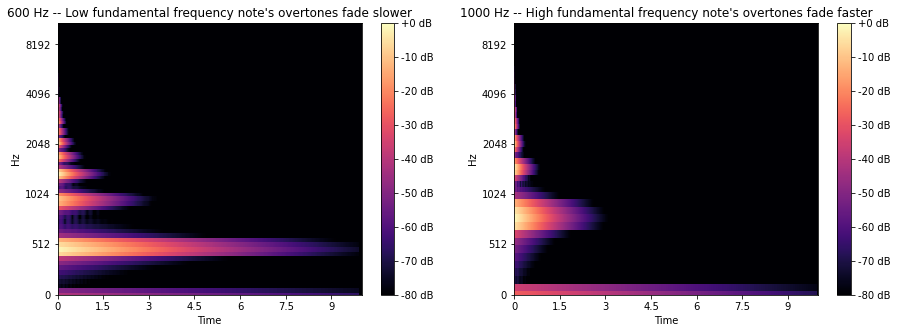

In [2]:
%pylab inline
import IPython.display
import librosa.display

sr = 44100
def acoustic(y, y_last_of_previous_period, period, speed_of_fading, isarray=True, fret_buzz=False):
    if isarray:
        return concatenate(([y_last_of_previous_period + y[0]] if not fret_buzz else zeros(1), (y[1:] + y[:-1]))) / speed_of_fading
    else:
        return ([(y_last_of_previous_period + y[0]) / 2] if not fret_buzz else [0]) + [(y[j - 1] + y[j]) / speed_of_fading for j in range(1, period)]

def ks(f, sr=44100, T=0.5, speed_of_fading=2, tone_func=rand, guitar_type=acoustic, overload=False, fret_buzz=False):
    period = sr // f
    y = tone_func(period)
    length = int(f * T)
    y -= y.mean()
    if (period if guitar_type == acoustic else 0) > 250:  # 1.According to numpy data structure, it works more efficiently than list when the size is greater than about 300
        y_total = y  # 2.When it comes to classical guitar, the guitar_type function will be introduced later, it needs to iterate all the time
        for i in range(length - 1):  # ,which is the disadvantage of the numpy array. Iterating over a list is faster. 
            y = guitar_type(y, y_total[i * period - 1], period, speed_of_fading, True, fret_buzz)
            y_total = concatenate((y_total, y))
        y_total = concatenate((y_total, zeros((int(sr * T) - len(y_total)))))  # Zeros padding to normalize the signal size
    else:
        y = y.tolist()
        y_total = [*y]  # a=[*b] is faster than a=b*1, a[:]=b, a=copy(b),a=b.copy()
        for i in range(length - 1):
            y = guitar_type(y, y_total[i * period - 1], period, speed_of_fading, False, fret_buzz)
            y_total += y
        y_total += [0] * (int(sr * T) - len(y_total))  # Zeros padding to normalize the signal size
        y_total = fromiter(y_total, dtype=float)  # fromiter() works faster than array() when its 1d-list
    y_total = y_total / np.max(abs(y_total)) * (2 ** (15 if not overload else 16) - 1)
    return y_total if not overload else y_total.astype(int16)
    
def plot_melspectrogram(y, f, s):
    subplot(s)
    title("%i Hz -- Low fundamental frequency note's overtones fade slower" % f if f <= 600 else "%i Hz -- High fundamental frequency note's overtones fade faster" % f)
    period = sr // f
    S = librosa.feature.melspectrogram(y, sr=sr, n_fft=period * 10, hop_length=period, n_mels=period)
    S_DB = librosa.power_to_db(S, ref=np.max)
    librosa.display.specshow(S_DB, sr=sr, hop_length=period, x_axis='time', y_axis='mel');
    plt.colorbar(format='%+2.0f dB')

figure(figsize=(15, 5))
plot_melspectrogram(ks(600, sr, 10, 2.001), 600, '121')
plot_melspectrogram(ks(1000, sr, 10, 2.001), 1000, '122')

#Below shows the result of filtering the whole wav directly

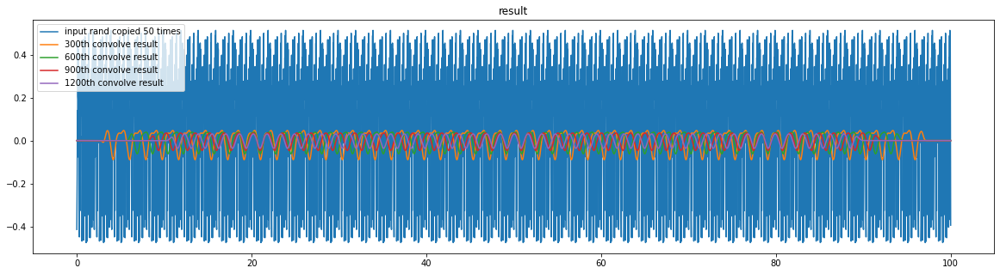

In [ ]:
f = 500
period = sr // f
y = rand(period)
y -= mean(y)
y = concatenate([y] * 50)
figure(figsize=(20, 5))
title('result')
for i in range(0, 1201):
    if i % 300 == 0:
        plot(linspace(0, 100, len(y)), y, label='%ith convolve result' % (i) if i > 0 else 'input rand copied 50 times')
    y = convolve(y, 0.5 * ones(2))
legend()
IPython.display.Audio(y, rate=sr)

#Below shows the result of filtering the wav period unit by period unit (the K-S algorithm)
The fact that the result of each previous period affects the result of the current period not only makes the noise fade gradually, but also makes this filtered signal more like a string sound gradually changing from loud to silent.

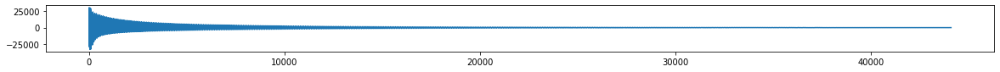

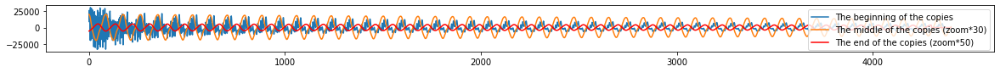

In [ ]:
y = ks(f, sr, 1, 2.0168)
figure(figsize=(20, 1))
plot(y)
figure(figsize=(20, 1))
plot(y[:period * 50], label='The beginning of the copies')
plot(y[len(y) // 2:len(y) // 2 + period * 50] * 30, label='The middle of the copies (zoom*30)')
plot(y[-period * 50:] * 50, 'r', label='The end of the copies (zoom*50)')
legend(loc='upper right')
IPython.display.Audio(y, rate=sr)

#Classical guitar sound physical modeling
Lets try to filters the sound time unit by time unit in each period, and then period unit by period unit for the whole sound wave:
 $$wav[t]=\frac{wav[t-Period-1]+wav[t-Period]}{2}$$
 $$wav[t-Period]=wav[t]$$

Since the sound is converging faster in terms of frequency (not in terms of release time), this makes it sounds more like the nylon strings of a classical guitar.
If you want to converge it faster in terms of "***release***", I mention it in section "Random tones"

The four audio below are: [low pitch note of acoustic guitar, low pitch note of classical guitar, high pitch note of acoustic guitar, high pitch note of classical guitar]


Populating the interactive namespace from numpy and matplotlib


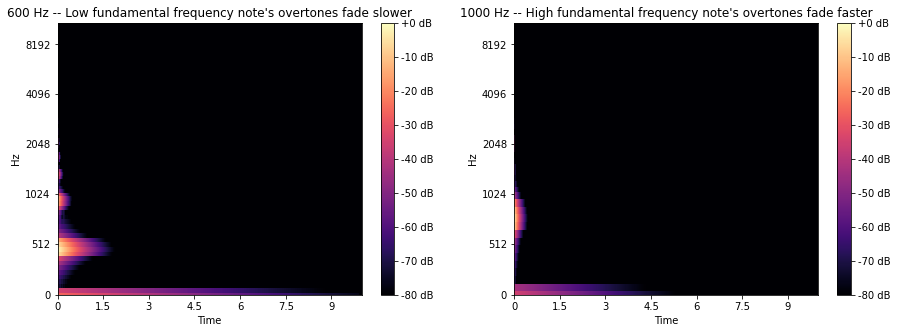

In [ ]:
def classical(y, y_last_of_previous_period, period, speed_of_fading, isarray=True, fret_buzz=False):
    for j in range(period):
        y[j] = (y[j - 1] + y[j]) / speed_of_fading
    return y if not fret_buzz else [0] + y[1:]

figure(figsize=(15, 5))
plot_melspectrogram(ks(600, sr, 10, 2.001, guitar_type=classical), 600, '121')
plot_melspectrogram(ks(1000, sr, 10, 2.001, guitar_type=classical), 1000, '122')
IPython.display.display(IPython.display.Audio(ks(100, sr, 2, 2.0368), rate=sr))
IPython.display.display(IPython.display.Audio(ks(100, sr, 2, 2.0268, guitar_type=classical), rate=sr))
IPython.display.display(IPython.display.Audio(ks(500, sr, 2, 2.0268), rate=sr))
IPython.display.display(IPython.display.Audio(ks(500, sr, 2, 2.0068, guitar_type=classical), rate=sr))

#Except for rand(), you can try any function here to change the tone.

In [ ]:
def electric_wah_tone(N):
    t = np.arange(0, 1, 1 / N)[:N]
    t1 = [log(n + 1e-9) for n in range(N)]
    return sin(2 * np.pi * t * t1)

y_wah = ks(150, sr, 2, 2.0268, electric_wah_tone)
IPython.display.Audio(y_wah, rate=sr)

#3 tuning parameters (low,middle,high) of Equalizer

value:[-1,inf], 0 means no change

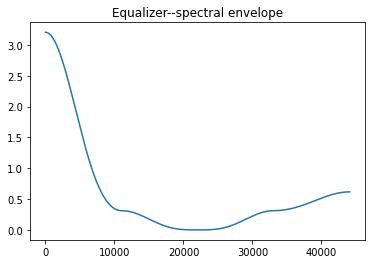

In [12]:
def eq(y_total, low: float, middle: float, high: float):
    e = hanning(len(y_total) // 4)
    e = concatenate([e] * 4)[len(y_total) // 8:len(y_total) // 8 * 5]
    e[:len(e) // 4] *= low
    e[len(e) // 4:len(e) // 4 * 3] *= middle
    e[len(e) // 4 * 3:] *= high
    e = (e / 2 + 0.5) ** 1.68
    figure()
    title("Equalizer--spectral envelope")
    plot(e)
    e = concatenate((e, [e[-1]] * (len(y_total) - len(e) * 2), e[::-1]))
    Y = abs(fft.fft(y_total)) * e
    y_total = fft.ifft(Y * exp(angle(fft.fft(y_total)) * 1j)).real
    return y_total[:-100]

y_eq = eq(y_wah, 3, -1, 0.5)  # value:[-1,inf], 0 means no change
IPython.display.Audio(y_eq, rate=sr)

#Frequencies of notes
The 88 notes of the piano start from A2 ($27.5Hz$) to C8. According to **12 equal temperament**, the frequency of each note is $2^{\frac{1}{12}}$ times of the left note's on the keyboard


In [ ]:
abcdefg = {0: "A", 1: "Bb", 2: "B", 3: "C", 4: "C#", 5: "D", 6: "Eb", 7: "E", 8: "F", 9: "F#", 10: "G", 11: "G#"}
def keys_generator(release, speed_of_fading=2, tone=rand, guitar_type=acoustic, overload=False, fret_buzz=False):
    return {abcdefg[n % 12] + str(n // 12 + 1): ks(int(27.5 * 2 ** (n / 12)), sr, release, speed_of_fading, tone, guitar_type, overload, fret_buzz) for n in range(88)}

keys = keys_generator(2, 2.0369)
%timeit keys_generator(1, 2.0369)
IPython.display.Audio(keys["C3"], rate=sr)

1 loop, best of 3: 411 ms per loop


#Play notes or chord (Amplitude adjustment)
Notice: Adding two signal together will change the amplitude. For signals of the same frequency, the worst case is $max(sin(x)+sin(x))=2*max(sin(x))$, the best case is $max(sin(x)+cos(x))=\sqrt{2}*max(sin(x))$, so I choose to divide the amplitude by $\sqrt{2}$ everytime we add two signal together. Of course there are more effective methods, since are adding signals of different frequencies all the time. However, I test my approach, see below.

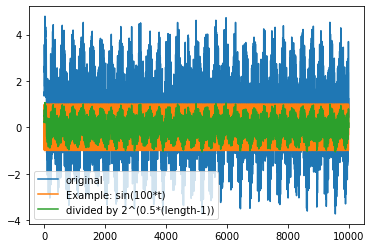

In [ ]:
t = linspace(0, 100, 10000)
y = [sin(30 * t), cos(2 * t), rand(10000), sin(11.43 * t ** t), cos(238 * t ** 23)]
N = len(y) - 1
y = sum(y, axis=0)
plot(y, label="original")
y /= 2 ** (0.5 * N)
y -= mean(y)
plot(sin(100 * t), label="Example: sin(100*t)")
plot(y, label="divided by 2^(0.5*(length-1))")
legend()

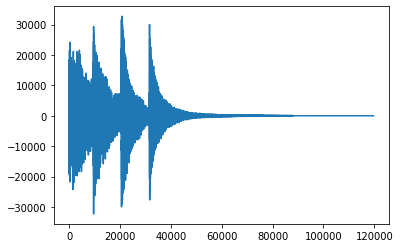

In [ ]:
def song_add(song, note, len_note):
    global speed
    length = int(song['length'] * sr)
    release = len(song['notes']) - length
    song['notes'][length:length + len(note)] += note[:release]
    song['notes'] = concatenate((song['notes'], note[release:]))
    song['notes'] = concatenate((song['notes'], zeros(max(0, int(1 + len_note / speed * sr - release)))))
    song['length'] += len_note / speed

def song_add_chord(song, notes, len_note, sweeping, velocity=1):  # why divide by 2^(0.5*(len(notes)-1))? max(sin(x))=1, max(cos(x)+sin(x))=2*(1/2)^0.5=2^0.5
    song_add(song, velocity * 2 * notes[0] / 2 ** (0.5 * (len(notes) - 1)), 0.0168 if sweeping else 0)  # root note
    for i in range(1, len(notes) - 1):
        song_add(song, velocity * notes[i] / 2 ** (0.5 * (len(notes) - 1)), 0.0168 if sweeping else 0)
    song_add(song, velocity * notes[-1] / 2 ** (0.5 * (len(notes) - 1)), len_note if not sweeping else len_note - 0.0168 * len(notes))

def play(y):
    play_obj = simpleaudio.play_buffer(y, 1, 2, 44100)
    play_obj.wait_done()

temple = 120
speed = temple / 240  # temple
Cmaj7 = {"length": 0, "notes": []}
song_add_chord(Cmaj7, [keys['C3'], keys['E3'], keys['G4'], keys['B5']], 1 / 8, True)
song_add(Cmaj7, keys['E4'], 1 / 8)
song_add(Cmaj7, keys['G4'], 1 / 8)
song_add(Cmaj7, keys['B5'], 1 / 8)

song = Cmaj7['notes']
song = eq(song, 0.8, -0.5, 0.1)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
plot(song)
IPython.display.Audio(song, rate=sr)

#Reverberation

In [ ]:
!wget http://www.openslr.org/resources/20/air_database_release_1_4.zip
!unzip air_database_release_1_4.zip
from scipy.io import loadmat
reverb_filter = loadmat('AIR_1_4/air_binaural_lecture_0_0_2.mat')['h_air'].flatten()

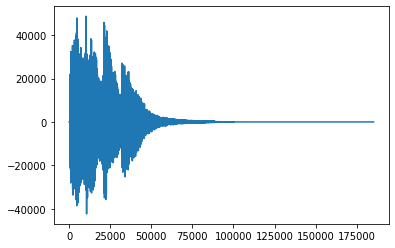

In [ ]:
r = convolve(song, reverb_filter)
plot(r)
IPython.display.Audio(r, rate=sr)

#Full version of all the codes above
Song: Autumn Leaves

Chords: 25147366

Populating the interactive namespace from numpy and matplotlib


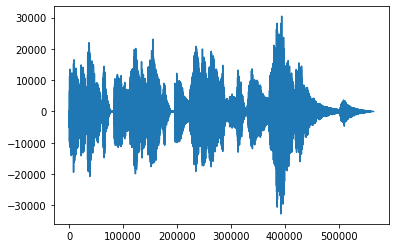

In [17]:
%pylab inline
import IPython.display

def electric_wah_tone(N):
    t = arange(0, 1, 1 / N)[:N]
    t1 = fromiter([log(n + 1e-9) for n in range(N)], dtype=float)
    return sin(2 * pi * t * t1)

def classical(y, y_last_of_previous_period, period, speed_of_fading, isarray=True, fret_buzz=False):
    for j in range(period):
        y[j] = (y[j - 1] + y[j]) / speed_of_fading
    return y if not fret_buzz else [0] + y[1:]
    
def acoustic(y, y_last_of_previous_period, period, speed_of_fading, isarray=True, fret_buzz=False):
    if isarray:
        return concatenate(([y_last_of_previous_period + y[0]] if not fret_buzz else zeros(1), (y[1:] + y[:-1]))) / speed_of_fading
    else:
        return ([(y_last_of_previous_period + y[0]) / 2] if not fret_buzz else [0]) + [(y[j - 1] + y[j]) / speed_of_fading for j in range(1, period)]

def ks(f, sr=44100, T=0.5, speed_of_fading=2, tone_func=rand, guitar_type=acoustic, overload=False, fret_buzz=False):
    period = sr // f
    y = tone_func(period)
    length = int(f * T)
    y -= y.mean()
    if (period if guitar_type == acoustic else 0) > 250:  # 1.According to numpy data structure, it works more efficiently than list when the size is greater than about 300
        y_total = y  # 2.When it comes to classical guitar, the guitar_type function will be introduced later, it needs to iterate all the time
        for i in range(length - 1):  # ,which is the disadvantage of the numpy array. Iterating over a list is faster. 
            y = guitar_type(y, y_total[i * period - 1], period, speed_of_fading, True, fret_buzz)
            y_total = concatenate((y_total, y))
        y_total = concatenate((y_total, zeros((int(sr * T) - len(y_total)))))  # Zeros padding to normalize the signal size
    else:
        y = y.tolist()
        y_total = [*y]  # a=[*b] is faster than a=b*1, a[:]=b, a=copy(b),a=b.copy()
        for i in range(length - 1):
            y = guitar_type(y, y_total[i * period - 1], period, speed_of_fading, False, fret_buzz)
            y_total += y
        y_total += [0] * (int(sr * T) - len(y_total))  # Zeros padding to normalize the signal size
        y_total = fromiter(y_total, dtype=float)  # fromiter() works faster than array() when its 1d-list
    y_total = y_total / np.max(abs(y_total)) * (2 ** (15 if not overload else 16) - 1)
    return y_total if not overload else y_total.astype(int16)

def eq(y_total, low: float, middle: float, high: float):
    e = hanning(len(y_total) // 4)
    e = concatenate([e] * 4)[len(y_total) // 8:len(y_total) // 8 * 5]
    e[:len(e) // 4] *= low
    e[len(e) // 4:len(e) // 4 * 3] *= middle
    e[len(e) // 4 * 3:] *= high
    e = (e / 2 + 0.5) ** 1.68
    e = concatenate((e, [e[-1]] * (len(y_total) - len(e) * 2), e[::-1]))
    Y = abs(fft.fft(y_total)) * e
    y_total = fft.ifft(Y * exp(angle(fft.fft(y_total)) * 1j)).real
    return y_total[:-100]

def keys_generator(release, speed_of_fading=2, tone=rand, guitar_type=acoustic, overload=False, fret_buzz=False):
    return {abcdefg[n % 12] + str(n // 12 + 1): ks(int(27.5 * 2 ** (n / 12)), sr, release, speed_of_fading, tone, guitar_type, overload, fret_buzz) for n in range(88)}

def song_add(song, note, len_note):
    global speed
    length = int(song['length'] * sr)
    release = len(song['notes']) - length
    song['notes'][length:length + len(note)] += note[:release]
    song['notes'] = concatenate((song['notes'], note[release:]))
    song['notes'] = concatenate((song['notes'], zeros(max(0, int(1 + len_note / speed * sr - release)))))
    song['length'] += len_note / speed

def song_add_chord(song, notes, len_note, sweeping, velocity=1):  # why divide by 2^(0.5*(len(notes)-1))? max(sin(x))=1, max(cos(x)+sin(x))=2*(1/2)^0.5=2^0.5
    song_add(song, velocity * 2 * notes[0] / 2 ** (0.5 * (len(notes) - 1)), 0.0168 if sweeping else 0)  # root note
    for i in range(1, len(notes) - 1):
        song_add(song, velocity * notes[i] / 2 ** (0.5 * (len(notes) - 1)), 0.0168 if sweeping else 0)
    song_add(song, velocity * notes[-1] / 2 ** (0.5 * (len(notes) - 1)), len_note if not sweeping else len_note - 0.0168 * len(notes))

def play(y):
    play_obj = simpleaudio.play_buffer(y, 1, 2, 44100)
    play_obj.wait_done()

sr = 44100
temple = 93
speed = temple / 240  # temple
abcdefg = {0: "A", 1: "Bb", 2: "B", 3: "C", 4: "C#", 5: "D", 6: "Eb", 7: "E", 8: "F", 9: "F#", 10: "G", 11: "G#"}
keys_1 = keys_generator(1.1, 2.0268, electric_wah_tone)
keys_0_5 = keys_generator(1.8, 2.0268, electric_wah_tone)
keys_2 = keys_generator(0.9 / 2, 2.0168, electric_wah_tone)
keys_8 = keys_generator(0.7 / 8, 2.0168, electric_wah_tone)
keys_16 = keys_generator(1.3 / 16, 2.013, electric_wah_tone)
song = {"length": 0, "notes": []}
song_add(song, keys_1['A4'], 1 / 16)
song_add(song, keys_1['B4'], 1 / 8)
song_add(song, keys_1['C4'], 1 / 8)
song_add_chord(song, [keys_2['D3'], keys_2['F3'], keys_2['C4'], keys_2['E4']], 0, True)
song_add(song, keys_1['F4'] * 1.5, 1 / 4)
song_add_chord(song, [keys_8['A3'], keys_8['C3'], keys_8['F#3'], keys_8['C4']], 3 / 16, False, 0.7)
song_add_chord(song, [keys_1['G2'] * 0.6, keys_1['B3'], keys_1['E4']], 1 / 4, False, 0.9)
song_add(song, keys_1['G3'], 1 / 16)
song_add(song, keys_1['A4'], 1 / 8)
song_add(song, keys_1['B4'], 1 / 8)
song_add_chord(song, [keys_2['C3'], keys_2['G3'], keys_2['B4'], keys_2['E4']], 0, True)
song_add(song, keys_1['E4'] * 1.3, 1 / 4)
song_add_chord(song, [keys_8['F#3'], keys_8['Bb4'], keys_8['E4'], keys_8['G#4']], 3 / 16, False, 0.7)
song_add_chord(song, [keys_1['F3'], keys_1['C4'], keys_1['E4'], keys_1['A5']], 1 / 4, False, 0.9)
song_add(song, keys_1['F3'], 1 / 16)
song_add(song, keys_1['G3'], 1 / 8)
song_add(song, keys_1['A4'], 1 / 8)
song_add_chord(song, [keys_2['B3'] * 0.5, keys_2['A4']], 0, False, 0.65)
song_add(song, keys_1['D4'] * 0.8, 1 / 8)
song_add(song, keys_2['D3'] * 0.2, 1 / 16)
song_add_chord(song, [keys_8['A4'] * 0.5, keys_8['D4']], 0.75 / 8, False, 0.8)
song_add(song, keys_2['D2'] * 0.2, 0.75 / 16)
song_add(song, keys_2['F2'] * 0.2, 1 / 8)
song_add_chord(song, [keys_16['A3'] * 0.6, keys_16['Eb3'], keys_16['G3'] * 1.5], 3 / 16, True, 0.78)
song_add_chord(song, [keys_1['E2'] * 0.35, keys_1['B3'], keys_1['E3'], keys_1['G#3']], 3 / 8, True)
song_add(song, keys_1['B3'] * 0.8, 1 / 16)
song_add(song, keys_2['G#3'], 0.75 / 16)
song_add(song, keys_2['F#3'], 0.75 / 16)
song_add(song, keys_2['E3'] * 0.6, 0.75 / 16)
song_add(song, keys_1['F#3'], 0.75 / 8)
song_add(song, keys_8['G#3'] * 0.6, 1 / 8)
song_add_chord(song, [keys_0_5['A3'] * 0.7, keys_0_5['E3'], keys_0_5['G3'], keys_0_5['C4']], 3 / 4, True)
song_add_chord(song, [keys_1['E3'] * 0.6, keys_1['G3'], keys_1['C#4']], 0, True, 0.3)

song_r = convolve(song['notes'], reverb_filter[:10000])
song = eq(song_r, 0.8, -0.5, 0.1)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
plot(song)
IPython.display.display(IPython.display.Audio(song, rate=sr))


#Random tones
PS: Violin has a moderate "***attack***" and long "***sustain***", change the "speed_of_release" under $2$. $$wav[t]=\frac{wav[t-P-1]+wav[t-P]}{speed\_of\_release}$$
Because $2$ is the $mean$ value, it is the balance point, it is the K-S algorithm when it is calculating the $mean$. The synthesized sound will converge faster in terms of time (not frequency) when $wav[t]<mean$ (speed_of_release>2), the "***attack***" of the sound will appear when $wav[t]>mean$ (speed_of_release<2)

In [ ]:
#@title Electric guitar-wah; Clean guitar; Classical Guitar; Violin; Piano

#Children Of Bodom - Bodom After Midnight

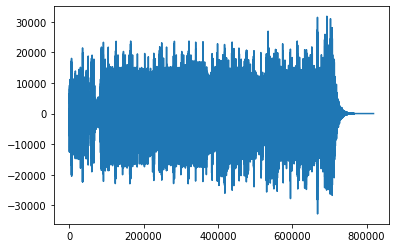

In [18]:
def ks_drum(f, sr=44100, T=0.5,speed_of_release=1.999,tom=False):
    period = sr // f
    y = electric_wah_tone(period)
    y = y - mean(y)
    y_total = y.tolist()
    length = int(f * T)
    for i in range(length - 1):
        y = [((rand()-1) if tom else (randint(0,2)*2-1))* (y[i - 1] + y[i]) / speed_of_release for i in range(period)]
        y_total += y
    y_total = zeros(int(sr * T))[:len(y_total)] + y_total[:int(sr * T)]  # Zeros padding to normalize the signal size
    y_total = y_total / np.max(abs(y_total)) * (2 ** 15 - 1)
    return y_total
    
temple=135
speed = temple/240  # temple
keys_8 ={k:eq(v,1,1,0)*1.5 for k,v in keys_generator(1.3/16,1.999,electric_wah_tone,overload=True).items()}
keys_8_low={k:eq(v,3,0,-0.8) for k,v in keys_8.items()}
keys_8_solo={k:eq(v,1,1,2) for k,v in keys_8.items()}
keys_4 =  {k:v.astype(int32)*1.7 for k,v in keys_generator(1.3/4,1.999,electric_wah_tone,overload=True).items()}
cymbal1=eq(convolve(convolve(convolve(eq(ks_drum(50, sr, 2,1.55), -0.90, 0, 0.5),ones(500)/500),reverb_filter)[:40000],reverb_filter),-0.5,1,3) *2500
cymbal2=convolve(convolve(convolve(eq(ks_drum(1000, sr, 2,1.55), -0.90, 0.5, 1),ones(500)/500),reverb_filter)[:40000],reverb_filter) *3000
hihat_opened=eq(convolve(convolve(eq(ks_drum(5000, sr, 2,1.45), -1, 0.3, 3),reverb_filter)[:40000],reverb_filter), -1, 0.3, 3) *48
hihat_closed=convolve(convolve(eq(ks_drum(20, sr, 0.5,1.3), -1, 0, 10)[100:-2000],ones(500)/500)[:3000],reverb_filter)*6000
snare = convolve(eq(ks_drum(100, sr, 0.2), -0.5, 5, 3),ones(300)/300) *400
drum = eq(convolve(eq(ks_drum(250, sr, 0.2), 100, 5, -1),ones(300)/300),100,0,0) *0.00005
tom = convolve(eq(ks_drum(150, sr, 1), 30, -1, -1),ones(300)/300)
toms =[hamming(20000)*(30*tom[:20000]+concatenate((zeros(2000),eq(convolve(eq(ks_drum(i, sr, 1,20,tom=True), 100, 5, -1),ones(400)/400)[:20000],-0.3,10,10)))[:20000])/4  for i in arange(9,19,2)]

song = {"length": 0, "notes": []}
def intro_drum(song):
  song_add(song,drum*11,1/16)
  song_add_chord(song,[hihat_opened,snare*7],1/16,False,0.5)
  song_add(song,drum*11,1/16)
  song_add_chord(song,[toms[4]],1/16,False)
  song_add_chord(song,[cymbal2,drum*6],1/16,False)
  song_add_chord(song,[toms[4]],1/16,False)
  song_add(song,drum*10,1/16)
  song_add_chord(song,[hihat_opened*3,toms[2]],1/16,False)
  song_add(song,drum*9,1/16)
  song_add_chord(song,[toms[2]],1/16,False)
  song_add(song,drum*8,1/16)
  song_add_chord(song,[toms[0]*0.5],1/16,False)
  song_add_chord(song,[toms[0]*0.5],1/16,False)
  song_add(song,cymbal1*5,1/8)
  song_add(song,cymbal1*5,1/8)
intro_drum(song)
song["notes"]/=10
def riff1(song,type=None):
    hihat = hihat_closed*2 if type==1 else hihat_opened/2
    song_add_chord(song, [cymbal1*3,cymbal2*3, drum*3,  keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False,0.9)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3,hihat_closed*6, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*1.5,  hihat_closed*4, keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat_closed*2, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*1.5, hihat_closed*4, keys_8['E3']*1.5, keys_8['B4']*1.5], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['G3'], keys_8['D4']], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [drum*1.5, hihat_closed*4, keys_8['F3']*2, keys_8['C4']*2], 1 / 16, False)
    song_add_chord(song, [hihat_closed, keys_8['D3'], keys_8['A4']], 1 / 16, False)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3, hihat*2, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)
    song_add_chord(song, [drum*3, hihat*2, keys_8_low['D3']*1.5, keys_8_low['A4']*1.5], 1 / 16, False, 0.5)
    song_add_chord(song, [hihat, keys_8_low['D3'], keys_8_low['A4']], 1 / 16, False, 0.5)

def riff2(song,type=None):
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal1*10, keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*9, snare*3.5, cymbal2*5,keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal2*3, keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, snare*1.5,cymbal2*3, keys_8['G#2']*2, keys_8['Eb3']*2], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*2, keys_8['G#2']*1.25, keys_8['Eb3']*1.25], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, snare*1.5, cymbal2*3if type == 1 else cymbal1*10,keys_8['Bb3']*3, keys_8['F3']*3], 1 / 16, False, 0.8)
    song_add(song,drum*2.5,1/16)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*6, snare*3.5,cymbal2*5if type == 1 else zeros(1000), keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, zeros(1000) if type == 1 else cymbal1*10,keys_8_low['Bb3']*2.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, zeros(1000) if type == 1 else snare*3.5 , keys_8_low['Bb3']*2.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*3, cymbal2*4 if type == 1 else zeros(1000),snare*3.5 if type == 1 else zeros(1000),keys_8_low['Bb3']*3], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*4.5, keys_8_low['Bb3']*1.5], 1 / 16, False, 0.3)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.8, keys_4['F#2'], keys_4['C#3']], 1 / 16, False, 0.8)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.3], 1 / 16, False)
    song_add_chord(song, [drum*2, cymbal2*0.8 if type == 1 else zeros(1000) ,snare*0.8], 1 / 16, False)
    song_add_chord(song, [drum*4, zeros(1000) if type == 1 else snare, keys_4['G#2'], keys_4['Eb3']], 1 / 16, False, 0.8)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else snare*0.4], 1 / 16, False)
    song_add_chord(song, [drum*2, zeros(1000) if type == 1 else hihat_opened*0.65], 1 / 16, False)


riff1(song,1)
song_add_chord(song, [cymbal1*1.5,drum*4,  keys_4['D3'], keys_4['A4'], keys_4['F3']], 3 / 16, False)
song_add_chord(song, [cymbal2,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
riff1(song)
song_add_chord(song, [cymbal1*1.5,drum*4,  keys_4['Bb3'], keys_4['F3'], keys_4['D3']], 3 / 16, False)
song_add_chord(song, [cymbal2,drum*4,  keys_4['C3'], keys_4['G3'], keys_4['E3']], 3 / 16, False)
song['notes']*=1.5
solo_1 = {"length": 0, "notes": []}
riff_2 = {"length": 0, "notes": []}
riff2(riff_2,1)
song_add(solo_1, keys_8_solo['C#5'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#4'], 1 / 16)
song_add(solo_1, keys_8_solo['F4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_1, keys_8_solo['C#4'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_1, keys_8_solo['G#3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['F3'], 1 / 16)
song_add(solo_1, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_1, keys_8_solo['C#3'], 1 / 16)
song_add(solo_1, keys_8_solo['Bb3'], 1 / 16)
solo_1['notes']=convolve(solo_1['notes'],reverb_filter)/2.5
song_add_chord(song, [solo_1["notes"], riff_2["notes"]*1.2], 2, False)
riff_2 = {"length": 0, "notes": []}
riff2(riff_2)
solo_2 = {"length": 0, "notes": []}
song_add(solo_2, keys_8_solo['Eb3'], 1 / 16)
song_add(solo_2, keys_8_solo['E3'], 1 / 16)
song_add(solo_2, keys_8_solo['F3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 2 / 16)
song_add(solo_2, keys_8_solo['F#3'], 1 / 16)
song_add(solo_2, keys_8_solo['G#3'], 1 / 16)
song_add(solo_2, keys_8_solo['A4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb4'], 1 / 16)
song_add(solo_2, keys_8_solo['C#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['Eb4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['E4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['F4'], 1 / 16)
song_add(solo_2, keys_8_solo['G4'], 1 / 16)
song_add(solo_2, keys_8_solo['G#4'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['Bb5'], 1 / 16)
song_add(solo_2, keys_8_solo['C5'], 1 / 16)
song_add(solo_2, keys_8_solo['C#5'], 1 / 16)
solo_2['notes']=convolve(solo_2['notes'],reverb_filter)/2.5
song_add_chord(song, [solo_2["notes"], riff_2["notes"]*1.2], 2, False)
song_add_chord(song, [drum*1.75,snare,cymbal1*3.5,cymbal2*3.5,keys_8_solo['D5'] ], 1 / 16, False)

song=convolve(song['notes'],reverb_filter[:sr//16])
song = eq(song, 0.5, 0.5, 0)  # value:[-1,inf], 0 means no change
song = array(song / np.max(abs(song)) * (2 ** 15 - 1), dtype=int16)
plot(song)
show()
IPython.display.display(IPython.display.Audio(song, rate=sr))

# Poor quality guitar (Fret buzz)


Populating the interactive namespace from numpy and matplotlib


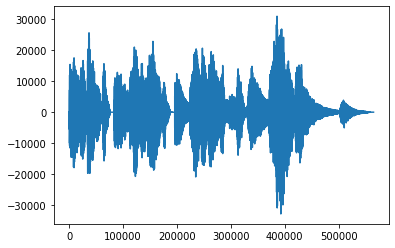

In [ ]:
IPython.display.display(IPython.display.Audio(ks(100,sr,2,2.03,fret_buzz=True),rate=sr))